In [ ]:
# NOTE: NOGLE KMEANS MANGLER STANDARDSCALER().FIT_TRANSFORM(X) INDEN DE ANVENDES!

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.cuda
import torchvision.transforms.functional as TF
import torchvision.transforms as transforms
import os
from joblib import dump, load
from PIL import Image
from tqdm.notebook import tqdm
from torch.nn.functional import relu
from torch.utils.data import DataLoader, Dataset
from SHG import SHG
from utils import *
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from sklearn.base import clone
from sklearn.preprocessing import StandardScaler

In [2]:
""" PATHS """
# Bottleneck data path
DATA_PATH = "C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/latent_space_data/data/"

# Ground truth heatmaps
HEATMAPS_PATH = "C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/train/heatmaps/"

# Path for model
MODEL_DIR = "C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/models/Mon_Apr_12_18-11-59_2021/epoch_46.pth"

# Path for mean rgb
average_rgb = np.loadtxt("./average_rgb.npy")

# Saving path
SAVING_PATH = "C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/latent_space/"

In [3]:
""" LOADING """
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

model_without_branches = SHG(num_hourglasses = 1, use_skip_connections = False).to(device)
model_with_branches = SHG(num_hourglasses = 1, use_skip_connections = True).to(device)

model_without_branches.load_state_dict(torch.load(MODEL_DIR))
model_with_branches.load_state_dict(torch.load(MODEL_DIR))

model_without_branches.eval()
model_with_branches.eval()

X, y, IDs = load_data(DATA_PATH, HEATMAPS_PATH)

In [4]:
""" PCA to 2D data """
scaler = StandardScaler().fit(X)
pca_2 = PCA(n_components=2).fit(scaler.transform(X))
X_2d = pca_2.transform(scaler.transform(X))
print("Explained variance:", np.sum(pca_2.explained_variance_ratio_))

Explained variance: 0.18793452


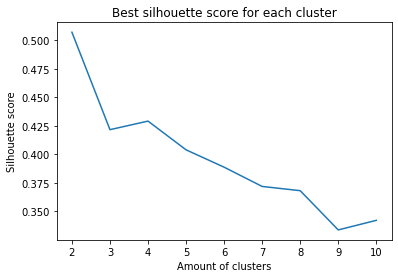

In [5]:
""" Running KMeans on the 2D data """
kmeans_model_2, centroids_2, labels = get_kmeans_alternative(X_2d, max_k = 10)

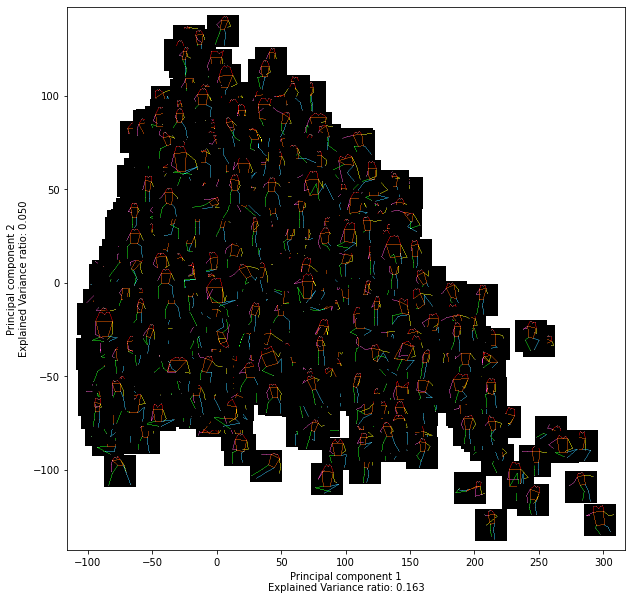

<Figure size 432x288 with 0 Axes>

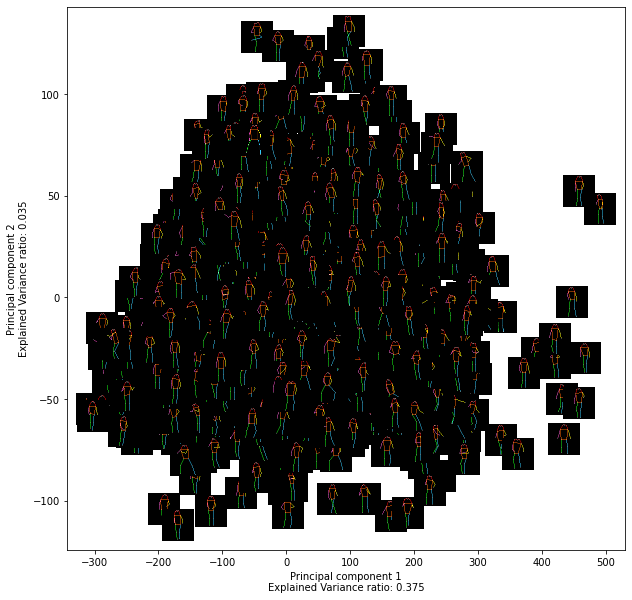

<Figure size 432x288 with 0 Axes>

In [6]:
""" Visualizing the clusters with pca"""
visualize_clusters_pca(X, y, labels)

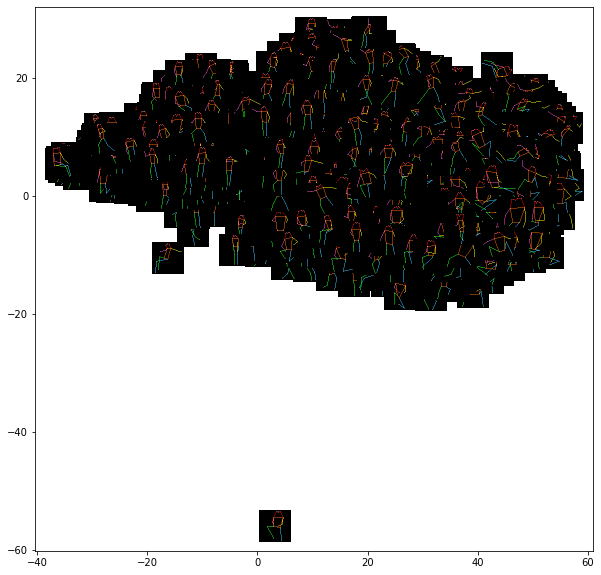

<Figure size 432x288 with 0 Axes>

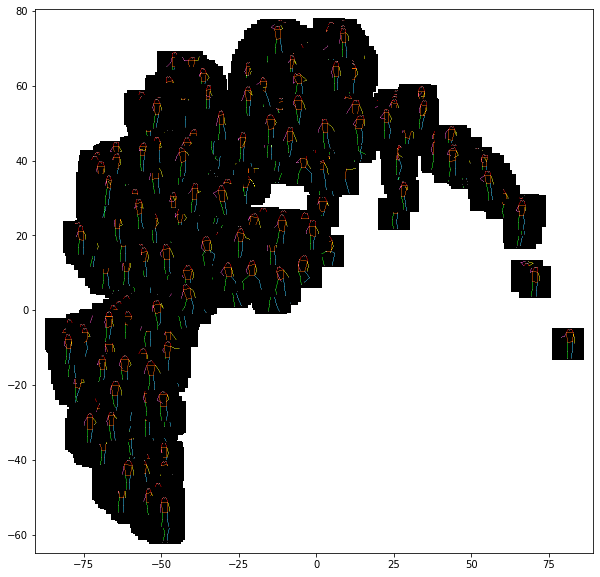

<Figure size 432x288 with 0 Axes>

In [7]:
""" Visualizing the clusters with t-SNE"""
visualize_clusters_tsne(X, y, labels)

In [8]:
""" Reverse PCA on the centroids """
centroids_2_inverted = scaler.inverse_transform(pca_2.inverse_transform(centroids_2)).reshape((centroids_2.shape[0], 256, 4, 4))

In [9]:
""" Decode the centroids """
centroids_2_decoded = model_without_branches.decode(torch.from_numpy(centroids_2_inverted).to(device, dtype = torch.float))

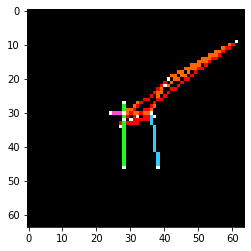

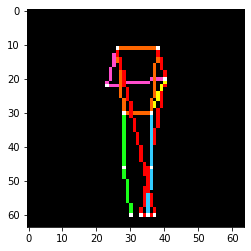

In [10]:
""" Visualize our predictions without skip-connections"""
closest_points_2 = []

for i, (centroid_decoded, centroid) in enumerate(zip(centroids_2_decoded, centroids_2)):
    kps = turn_featuremaps_to_keypoints(centroid_decoded.cpu())
    skeleton = draw_skeleton(kps)
    plt.imshow(skeleton)
    #plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/latent_space/2d_predictions_with_skip/kmeans_{}.png".format(i))
    plt.show()

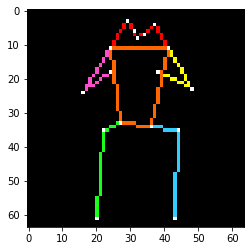

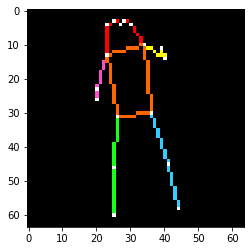

In [15]:
""" Visualizing the ground truth heatmaps """
closest_points_2_ID = []
closest_points_2 = np.array(closest_points_2).reshape((len(centroids_2_inverted), -1))
closest_kp_2 = []

for centroid in centroids_2:
    dists = np.linalg.norm(centroid - X_2d, axis = 1)
    true_heatmaps = y[np.argmin(dists)]
    closest_points_2_ID.append(IDs[np.argmin(dists)][:-4])
    kp = turn_featuremaps_to_keypoints(true_heatmaps)
    closest_kp_2.append(kp)
    skeleton = draw_skeleton(kp)
    plt.imshow(skeleton)
    plt.show()

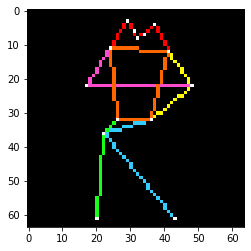

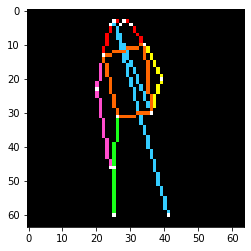

In [16]:
""" Looking at predictions with skip-connections """
for x, y_ in zip(closest_points_2_ID, closest_kp_2):
    x = Image.open("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/train/image/" + x + ".png")
    x = TF.to_tensor(x)
    TF.normalize(x, average_rgb, [1, 1, 1], inplace = True)
    x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
    x = x.to(device, dtype = torch.float)
    pred, _ = model_with_branches(x)
    pred = pred.cpu()
    pred = turn_featuremaps_to_keypoints(pred)
    skeleton = draw_necessary_skeleton(pred, y_)
    plt.imshow(skeleton)
    plt.show()

In [17]:
""" Now we do the same, but instead with 625 components, which explains 95% of the variance """
pca_625 = PCA(n_components = 625).fit(scaler.transform(X))
X_625d = pca_625.transform(scaler.transform(X))
print("Explained variance:", np.sum(pca_625.explained_variance_ratio_))

Explained variance: 0.9502023


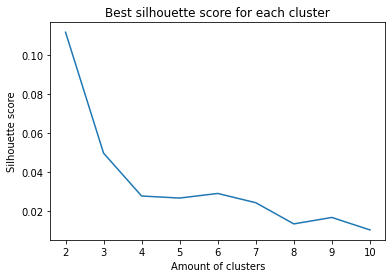

In [18]:
""" Running KMeans on the 625D data """
kmeans_model_625, centroids_625, labels = get_kmeans_alternative(X_625d, max_k = 10)

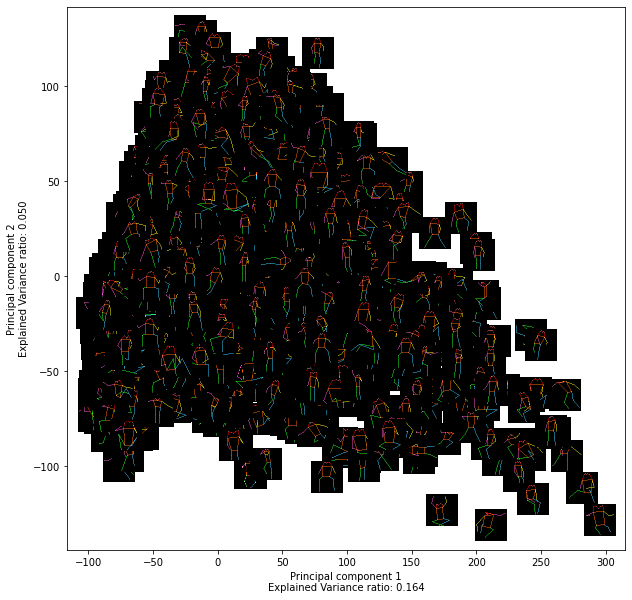

<Figure size 432x288 with 0 Axes>

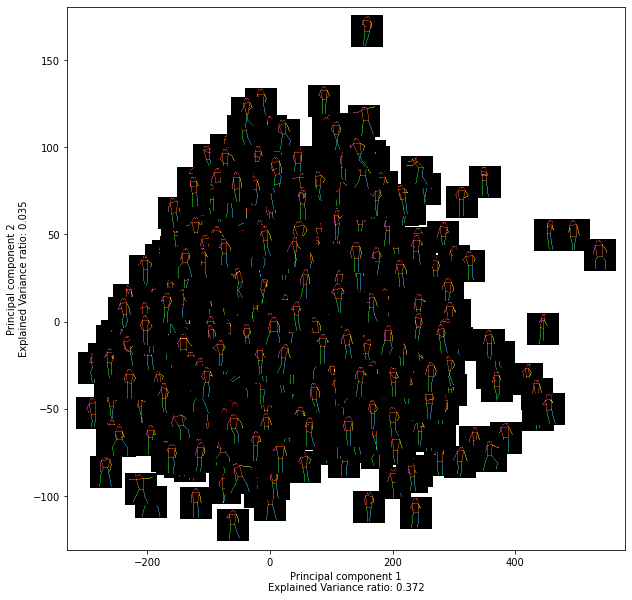

<Figure size 432x288 with 0 Axes>

In [19]:
""" Visualizing the clusters with PCA"""
visualize_clusters_pca(X, y, kmeans_model_625.labels_)

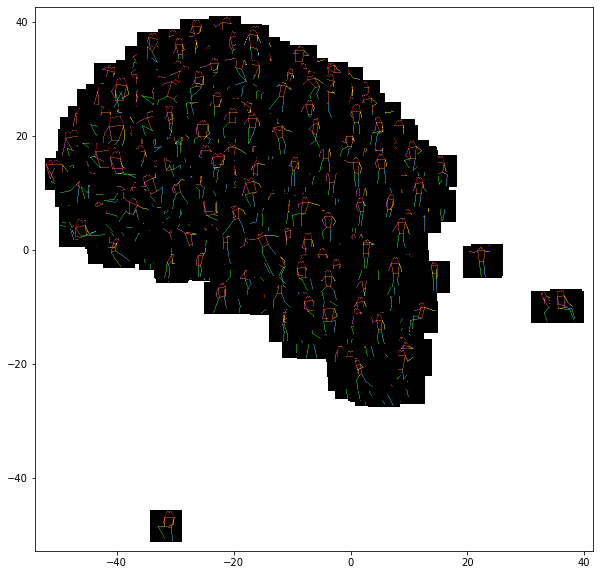

<Figure size 432x288 with 0 Axes>

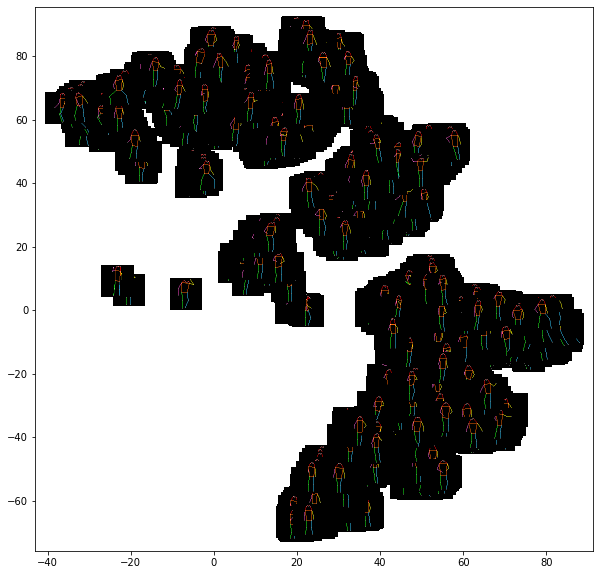

<Figure size 432x288 with 0 Axes>

In [20]:
""" Visualizing the clusters with t-SNE"""
visualize_clusters_tsne(X, y, kmeans_model_625.labels_)

In [21]:
""" Reversing the centroids """
centroids_625_inverted = scaler.inverse_transform(pca_625.inverse_transform(centroids_625)).reshape((centroids_625.shape[0], 256, 4, 4))

In [22]:
""" Decode the centroids """
centroids_625_decoded = model_without_branches.decode(torch.from_numpy(centroids_625_inverted).to(device, dtype = torch.float))

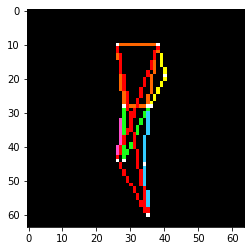

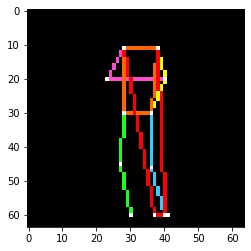

In [23]:
""" Visualize our predictions without skip-connections"""
closest_points_625 = []

for i, (centroid_decoded, centroid) in enumerate(zip(centroids_625_decoded, centroids_625)):
    kps = turn_featuremaps_to_keypoints(centroid_decoded.cpu())
    skeleton = draw_skeleton(kps)
    plt.imshow(skeleton)
    #plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/latent_space/2d_predictions_with_skip/kmeans_{}.png".format(i))
    plt.show()

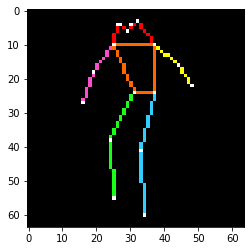

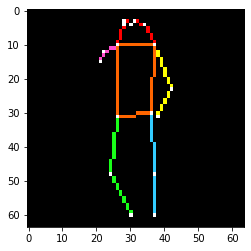

In [34]:
""" Visualizing the ground truth of the centroids """
closest_points_625_ID = []
closest_points_625 = np.array(closest_points_625).reshape((len(centroids_625_inverted), -1))
closest_kp_625 = []

for centroid in centroids_625:
    dists = np.linalg.norm(centroid - X_625d, axis = 1)
    true_heatmaps = y[np.argmin(dists)]
    closest_points_625_ID.append(IDs[np.argmin(dists)][:-4])
    kp = turn_featuremaps_to_keypoints(true_heatmaps)
    closest_kp_625.append(kp)
    skeleton = draw_skeleton(kp)
    plt.imshow(skeleton)
    plt.show()

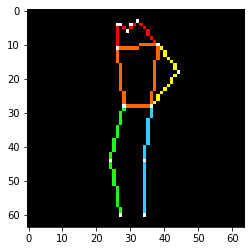

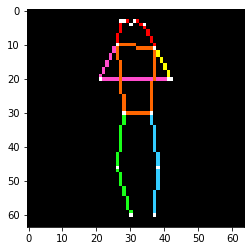

In [35]:
""" Looking at predictions with branches """
for x, y_ in zip(closest_points_625_ID, closest_kp_625):
    x = Image.open("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/train/image/" + x + ".png")
    x = TF.to_tensor(x)
    TF.normalize(x, average_rgb, [1, 1, 1], inplace = True)
    x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
    x = x.to(device, dtype = torch.float)
    pred, _ = model_with_branches(x)
    pred = pred.cpu()
    pred = turn_featuremaps_to_keypoints(pred)
    skeleton = draw_necessary_skeleton(pred, y_)
    plt.imshow(skeleton)
    plt.show()

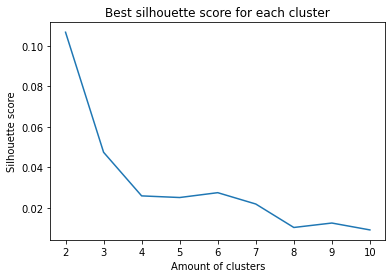

In [5]:
""" We now do the same on all of the feature (thus, without PCA). First we run KMeans on all of the data"""
kmeans_full_model, centroids_full, labels = get_kmeans_alternative(StandardScaler().fit_transform(X), max_k = 10)

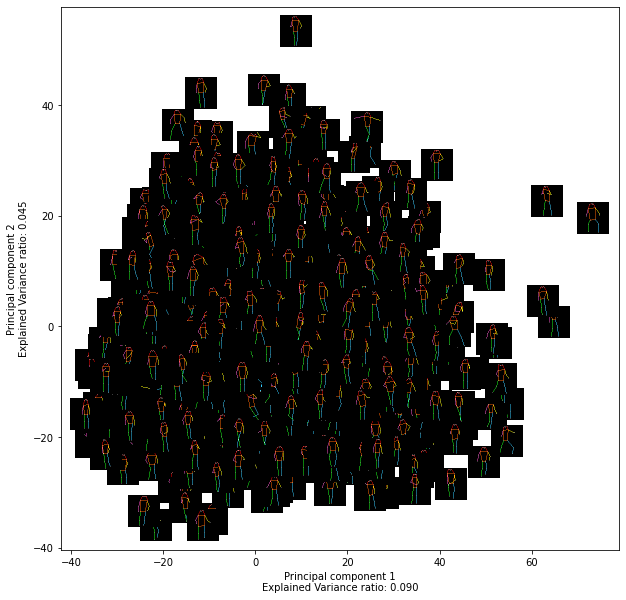

<Figure size 432x288 with 0 Axes>

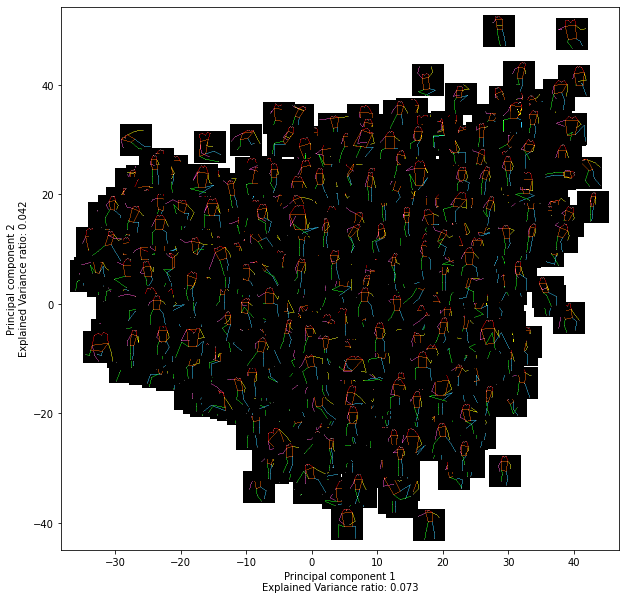

<Figure size 432x288 with 0 Axes>

In [6]:
""" Visualizing the clusters with PCA"""
visualize_clusters_pca(X, y, kmeans_full_model.labels_)

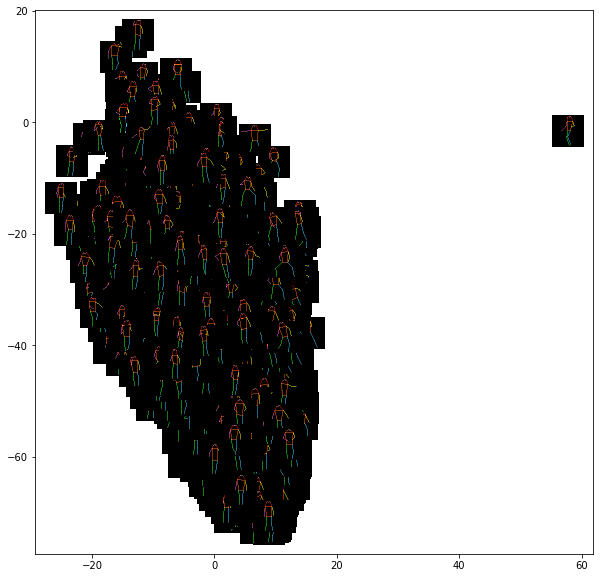

<Figure size 432x288 with 0 Axes>

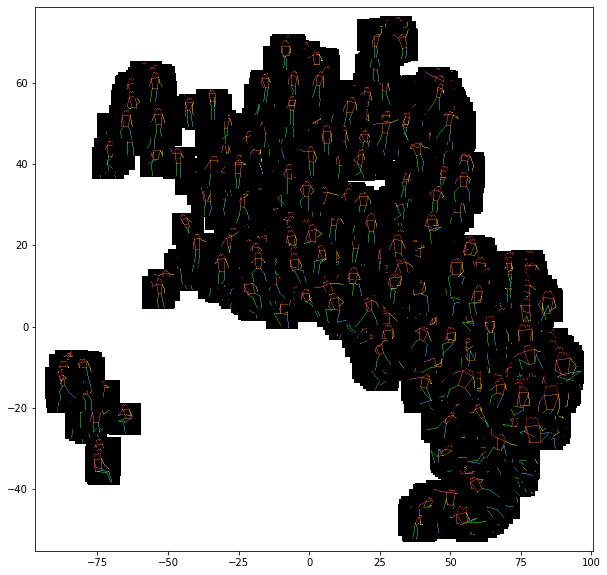

<Figure size 432x288 with 0 Axes>

In [16]:
""" Visualizing the clusters with t-SNE"""
visualize_clusters_tsne(X, y, kmeans_full_model.labels_)

In [7]:
""" Decode the centroids """
centroids_full_decoded = model_without_branches.decode(torch.from_numpy(centroids_full).reshape((centroids_full.shape[0], 256, 4, 4)).to(device, dtype = torch.float))

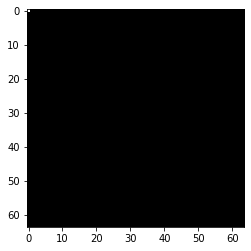

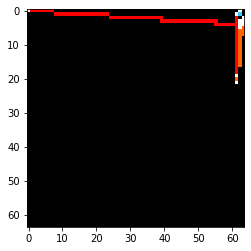

In [8]:
""" Visualize our predictions without skip-connections"""
closest_points_full = []

for i, (centroid_decoded, centroid) in enumerate(zip(centroids_full_decoded, centroids_full)):
    kps = turn_featuremaps_to_keypoints(centroid_decoded.cpu())
    skeleton = draw_skeleton(kps)
    plt.imshow(skeleton)
    #plt.savefig("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/latent_space/2d_predictions_with_skip/kmeans_{}.png".format(i))
    plt.show()

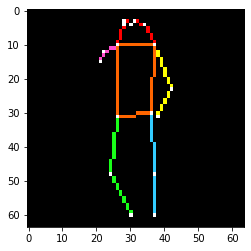

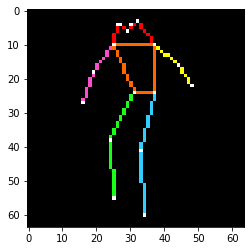

In [14]:
""" Visualizing the ground truth heatmap """
closest_points_full_ID = []
closest_points_full = np.array(closest_points_full).reshape((len(centroids_full_decoded), -1))
closest_kp_full = []

for centroid in centroids_full:
    dists = np.linalg.norm(centroid - StandardScaler().fit_transform(X), axis = 1)
    true_heatmaps = y[np.argmin(dists)]
    closest_points_full_ID.append(IDs[np.argmin(dists)][:-4])
    kp = turn_featuremaps_to_keypoints(true_heatmaps)
    closest_kp_full.append(kp)
    skeleton = draw_skeleton(kp)
    plt.imshow(skeleton)
    plt.show()

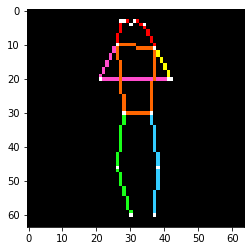

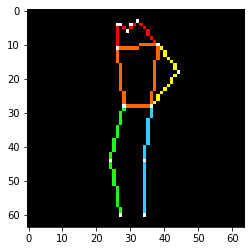

In [15]:
""" Looking at predictions with skip-connections """
for x, y_ in zip(closest_points_full_ID, closest_kp_full):
    x = Image.open("C:/Users/André/OneDrive 2/OneDrive/Skrivebord/bsc_data/train/image/" + x + ".png")
    x = TF.to_tensor(x)
    TF.normalize(x, average_rgb, [1, 1, 1], inplace = True)
    x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
    x = x.to(device, dtype = torch.float)
    pred, _ = model_with_branches(x)
    pred = pred.cpu()
    pred = turn_featuremaps_to_keypoints(pred)
    skeleton = draw_necessary_skeleton(pred, y_)
    plt.imshow(skeleton)
    plt.show()